In [3]:
import os
import torch

!git clone https://github.com/ultralytics/yolov5 
!pip install huggingface_hub
!pip install wandb

fatal: destination path 'yolov5' already exists and is not an empty directory.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 54.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 23.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 201.7/201.7 kB 26.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 9.7 MB/s eta 0:00:00
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8807 sha256=5ee89aecdf1326cddf19ea5fc2e5aa603b645f394af59675e8b3391435ffc0f4
  Stored in directory: /root/.cache/pip/wheels/e7/f3/22/152153d6eb222ee7a56ff8617d80ee5207207a8c00a7aab794
Successfully built pathtools


In [4]:
%cd yolov5
%pip install -qr requirements.txt  # install

/content/yolov5


In [5]:
os.makedirs("../datasets/", exist_ok=True)
%cd ../datasets/

/content/datasets


In [6]:
# Connecting to wandb
import wandb
import sys

def wandb_colab_login():
  sys.modules["google.colab2"] = sys.modules["google.colab"]
  del sys.modules["google.colab"]
  wandb.login()
  sys.modules["google.colab"] = sys.modules["google.colab2"]

wandb_colab_login()

ERROR:wandb.jupyter:Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [8]:
#importing the dataset images from roboflow

!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="3IRzRgbqNeg5dSgLNVXJ")
project = rf.workspace("lucas-nardi-baroni-w0bvx").project("animal-dataset-ehsm2")
dataset = project.version(5).download("folder")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.2/56.2 kB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 10.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 9.0 MB/s eta 0:00:00
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9676 sha256=e48b6c0dc7a5a387b0c7175cc274c3c6dd7bfbdefd2ebab8fafc0093e273ed4b
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.0.9
    Uninstalling pyparsing-3.0.9:
      Successfully uninstalled pyparsing-3.0.9
  Attempting uninstall: idna
    Found existing installation: idna 3.4
    Uninstalling idna-3.4:
   

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Animal-dataset-5 in folder:: 100%|██████████| 355/355 [00:00<00:00, 2251.99it/s]


In [9]:
dataset_name = dataset.location.split(os.sep)[-1]
os.environ["DATASET_NAME"] = dataset_name

In [10]:
%cd ../yolov5
!python classify/train.py --model yolov5m-cls.pt --data $DATASET_NAME --epochs 350 --batch 32 --img 640 --pretrained weights/yolov5m-cls.pt --cache

/content/yolov5
wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
wandb: Currently logged in as: lucas-nardi-baroni. Use `wandb login --relogin` to force relogin
classify/train: model=yolov5m-cls.pt, data=Animal-dataset-5, epochs=350, batch_size=32, imgsz=640, nosave=False, cache=ram, device=, workers=8, project=runs/train-cls, name=exp, exist_ok=False, pretrained=weights/yolov5m-cls.pt, optimizer=Adam, lr0=0.001, decay=5e-05, label_smoothing=0.1, cutoff=None, dropout=None, verbose=False, seed=0, local_rank=-1
github: up to date with https://github.com/ultralytics/yolov5 ✅
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-160-g867f7f0 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

TensorBoard: Start with 'tensorboard --logdir runs/train-cls', view at http://localhost:6006/
wandb: Tracking run with wandb version 0.15.0
wandb: Run data

In [11]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [12]:
!python classify/val.py --weights runs/train-cls/exp/weights/best.pt --data ../datasets/$DATASET_NAME

classify/val: data=../datasets/Animal-dataset-5, weights=['runs/train-cls/exp/weights/best.pt'], batch_size=128, imgsz=224, device=, workers=8, verbose=True, project=runs/val-cls, name=exp, exist_ok=False, half=False, dnn=False
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-160-g867f7f0 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 166 layers, 11671316 parameters, 0 gradients, 30.6 GFLOPs
testing: 100% 1/1 [00:01<00:00,  1.39s/it]
                   Class      Images    top1_acc    top5_acc
                     all          95       0.547           1
                     cat          11       0.636           1
                     dog          24       0.292           1
                  monkey          36       0.528           1
                     owl          24       0.792           1
Speed: 0.1ms pre-process, 1.9ms inference, 0.1ms post-process per image at shape (1, 3, 224, 224)
Results saved to run

## Testando o modelo treinado

In [32]:
if os.path.exists(os.path.join(dataset.location, "test/dog")):
  split_path = os.path.join(dataset.location, "test/dog ")
  os.environ["TEST_IMAGES_DOG_PATH"] = os.path.join(dataset.location, "test/dog/")
else:
  os.environ["TEST_IMAGES_DOG_PATH"] = os.path.join(dataset.location, "valid/dog/")

!python classify/predict.py --weights runs/train-cls/exp/weights/best.pt --img 640 --source $TEST_IMAGES_DOG_PATH

classify/predict: weights=['runs/train-cls/exp/weights/best.pt'], source=/content/datasets/Animal-dataset-5/test/dog/, data=data/coco128.yaml, imgsz=[640, 640], device=, view_img=False, save_txt=False, nosave=False, augment=False, visualize=False, update=False, project=runs/predict-cls, name=exp, exist_ok=False, half=False, dnn=False, vid_stride=1
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-160-g867f7f0 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 166 layers, 11671316 parameters, 0 gradients, 30.6 GFLOPs
image 1/24 /content/datasets/Animal-dataset-5/test/dog/1d2407684ad2e6249875709149960c5d_jpg.rf.3b02d3083f8a82e30e9fb17ab371e0d9.jpg: 640x640 owl 0.43, dog 0.37, cat 0.18, monkey 0.03, 17.0ms
image 2/24 /content/datasets/Animal-dataset-5/test/dog/4487e6125d545ed50a37cbefc6cea5ab745ecd179c1194bd81f5ecb94d7d0519_jpg.rf.60a73fde56b8e4d3860f654d154b391a.jpg: 640x640 dog 0.50, owl 0.43, monkey 0.07, cat 0.00

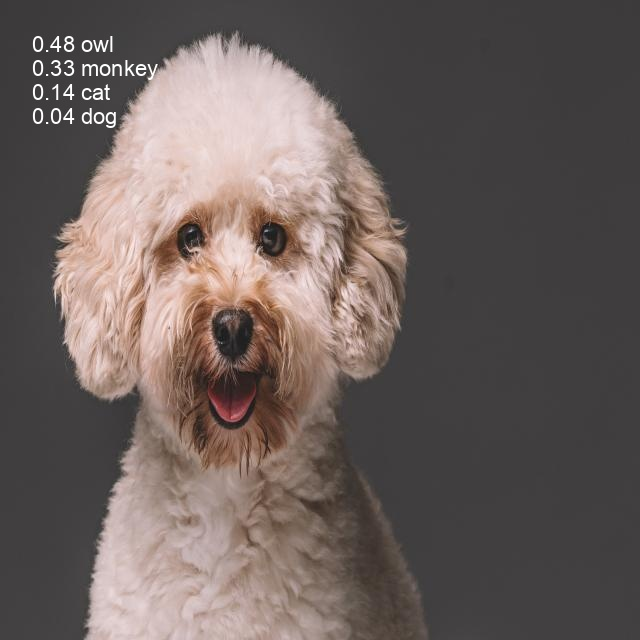

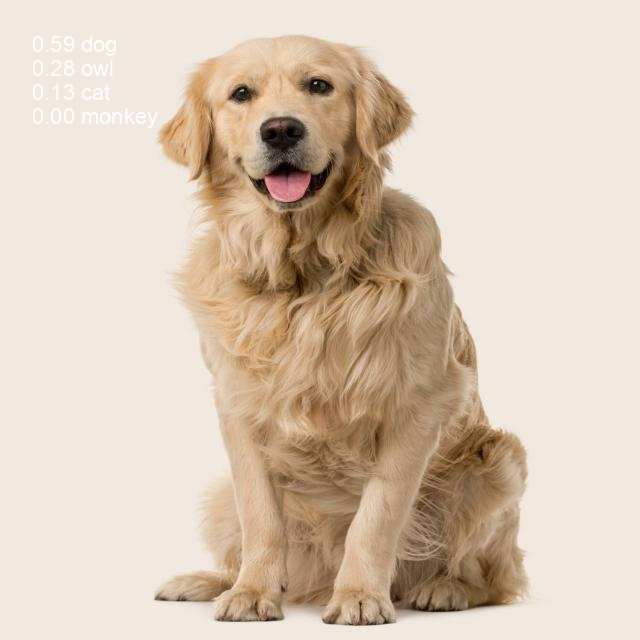

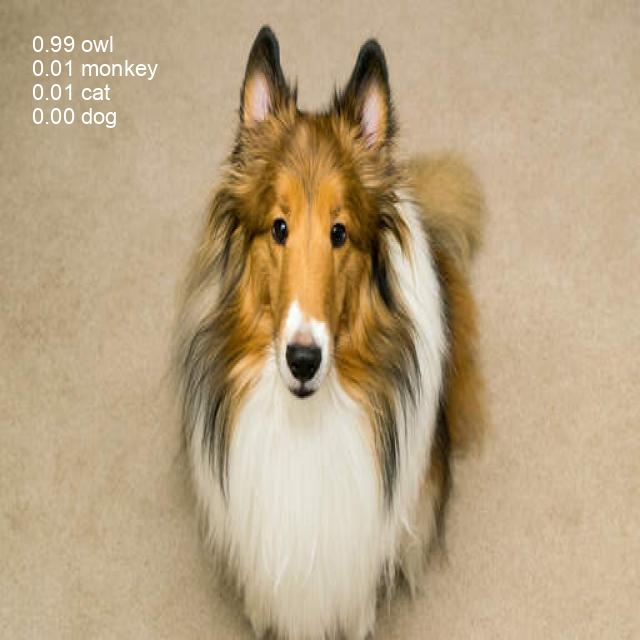

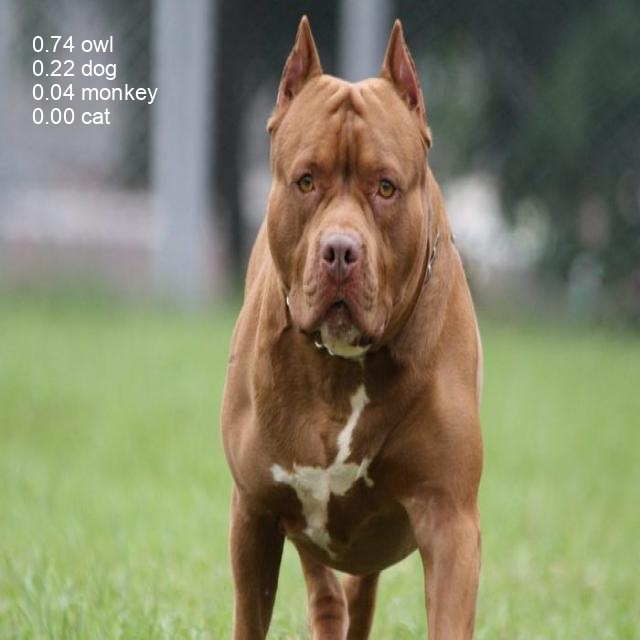

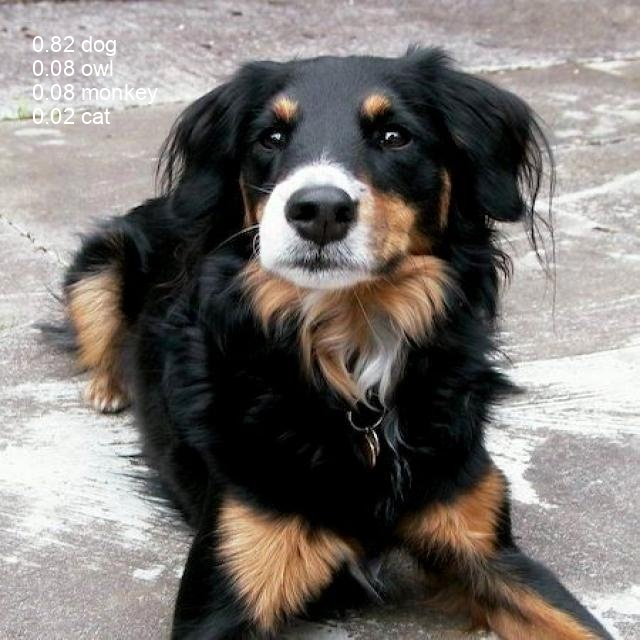

...

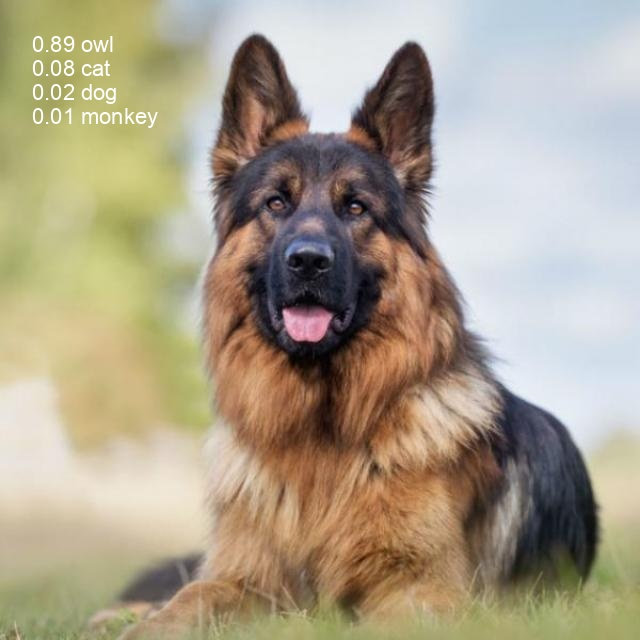

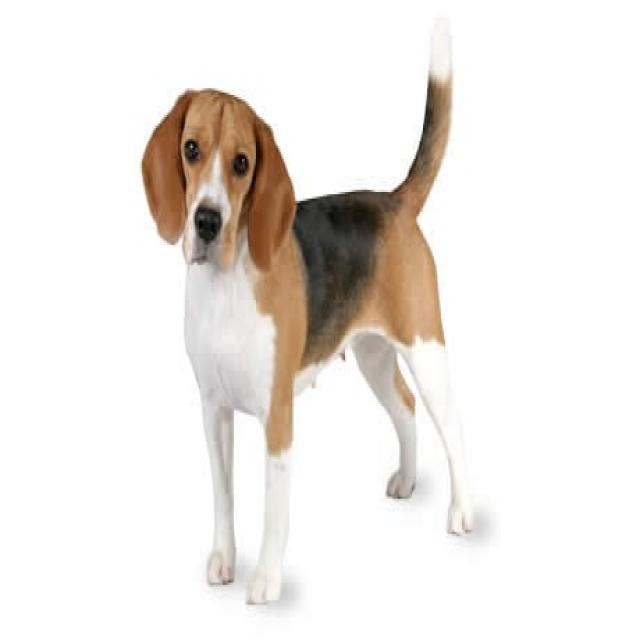

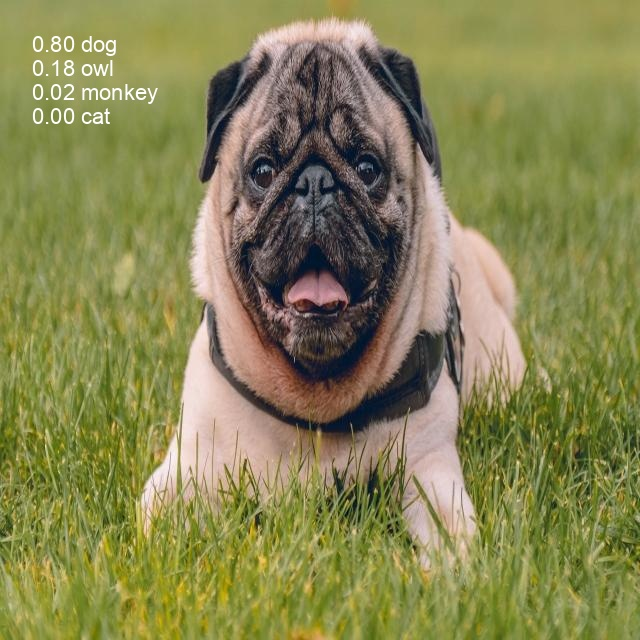

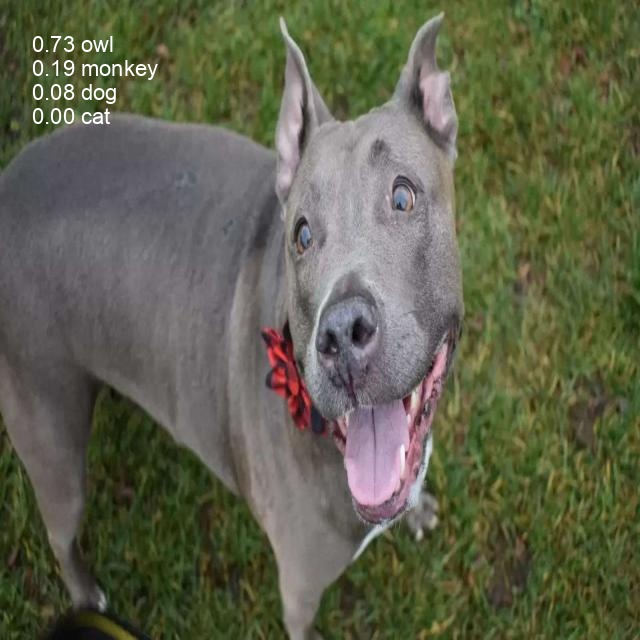

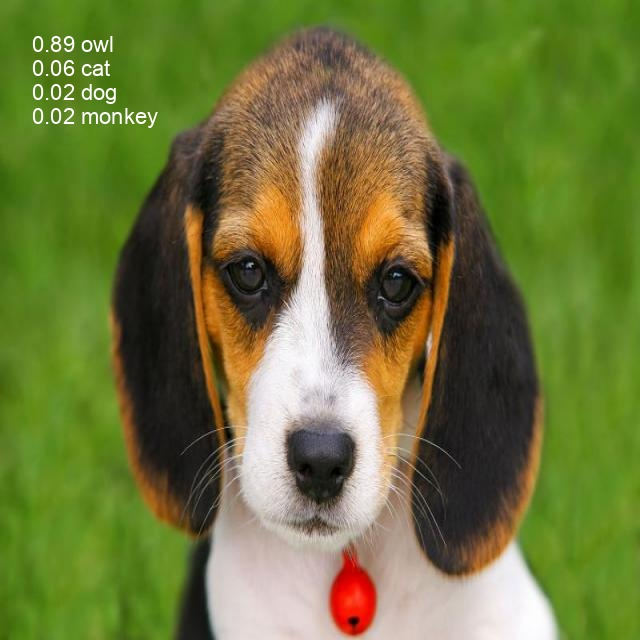

In [35]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/predict-cls/exp4/*.jpg'):
    display(Image(filename=imageName))
    print("\n")

In [36]:
if os.path.exists(os.path.join(dataset.location, "test/cat")):
  split_path = os.path.join(dataset.location, "test/cat ")
  os.environ["TEST_IMAGES_CAT_PATH"] = os.path.join(dataset.location, "test/cat/")
else:
  os.environ["TEST_IMAGES_CAT_PATH"] = os.path.join(dataset.location, "valid/cat/")

!python classify/predict.py --weights runs/train-cls/exp/weights/best.pt --img 640 --source $TEST_IMAGES_CAT_PATH

classify/predict: weights=['runs/train-cls/exp/weights/best.pt'], source=/content/datasets/Animal-dataset-5/test/cat/, data=data/coco128.yaml, imgsz=[640, 640], device=, view_img=False, save_txt=False, nosave=False, augment=False, visualize=False, update=False, project=runs/predict-cls, name=exp, exist_ok=False, half=False, dnn=False, vid_stride=1
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-160-g867f7f0 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 166 layers, 11671316 parameters, 0 gradients, 30.6 GFLOPs
image 1/11 /content/datasets/Animal-dataset-5/test/cat/gato-10-_jpg.rf.362533e9d765d180ed07253869b2796e.jpg: 640x640 cat 0.80, monkey 0.14, owl 0.06, dog 0.01, 17.0ms
image 2/11 /content/datasets/Animal-dataset-5/test/cat/gato-12-_jpg.rf.02c26fcb872d2b91ff74503cc0db4c4d.jpg: 640x640 cat 0.74, owl 0.10, monkey 0.10, dog 0.06, 17.0ms
image 3/11 /content/datasets/Animal-dataset-5/test/cat/gato-19-_jpg.rf.

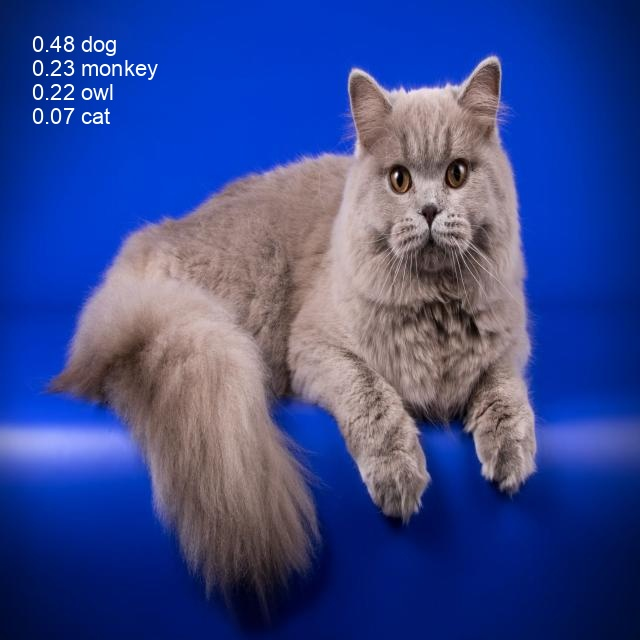

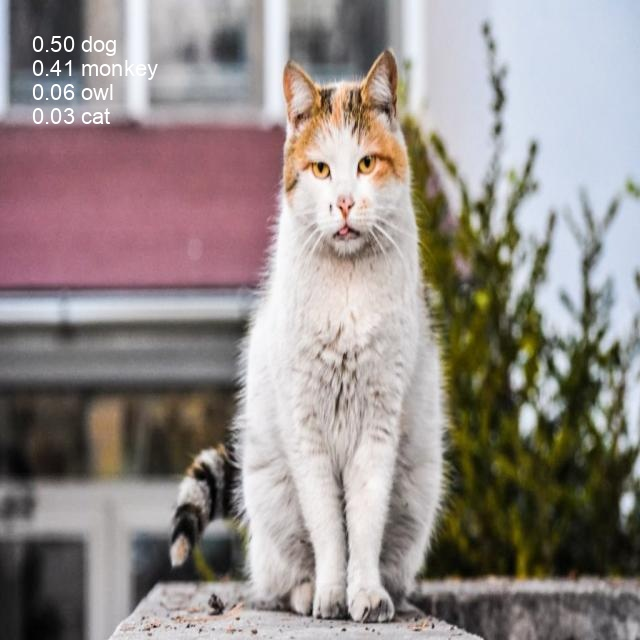

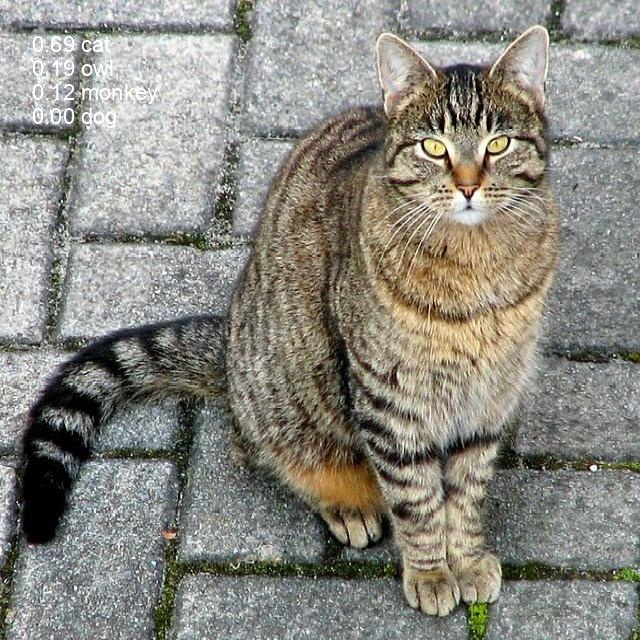

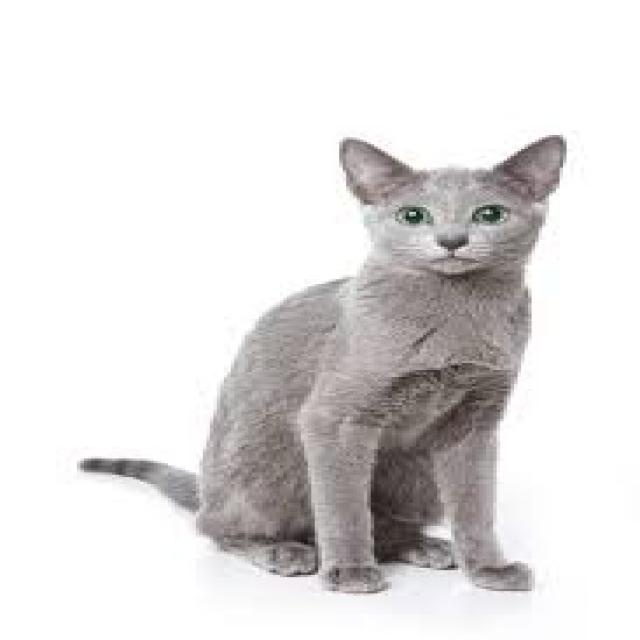

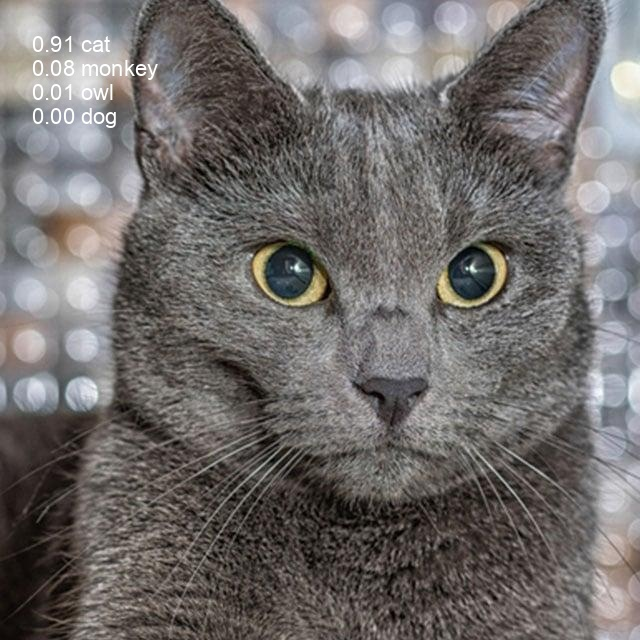

...

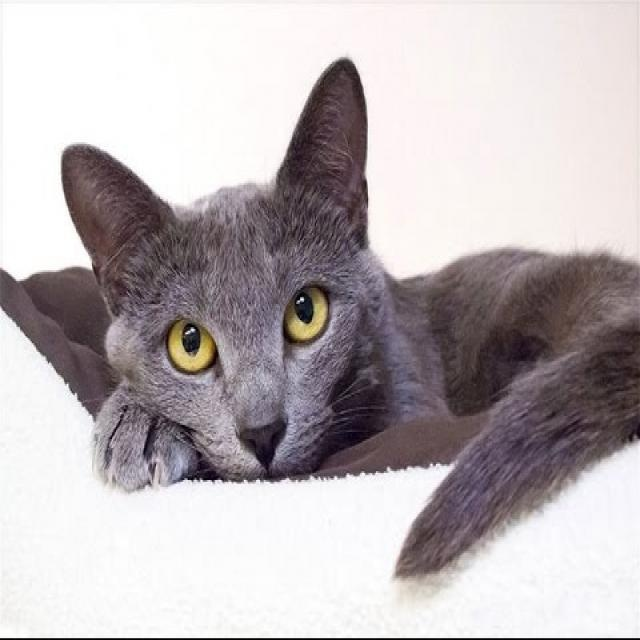

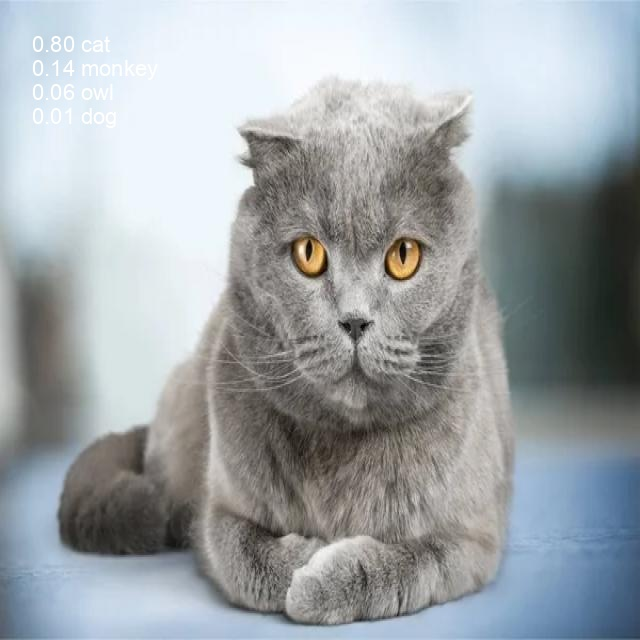

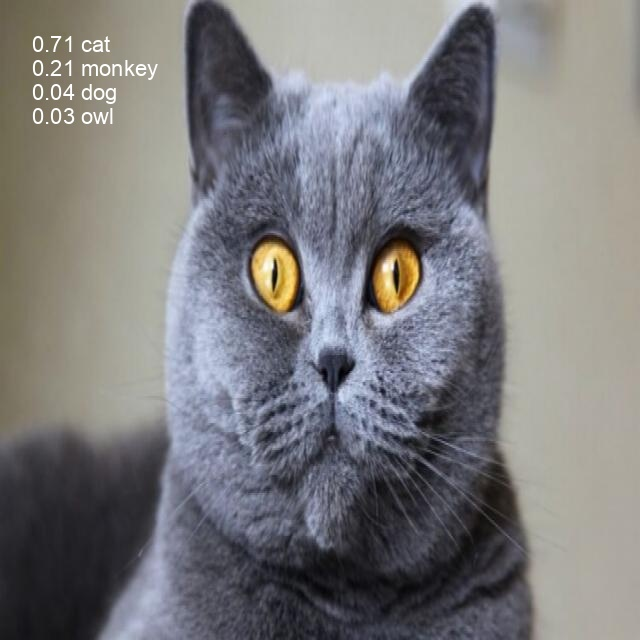

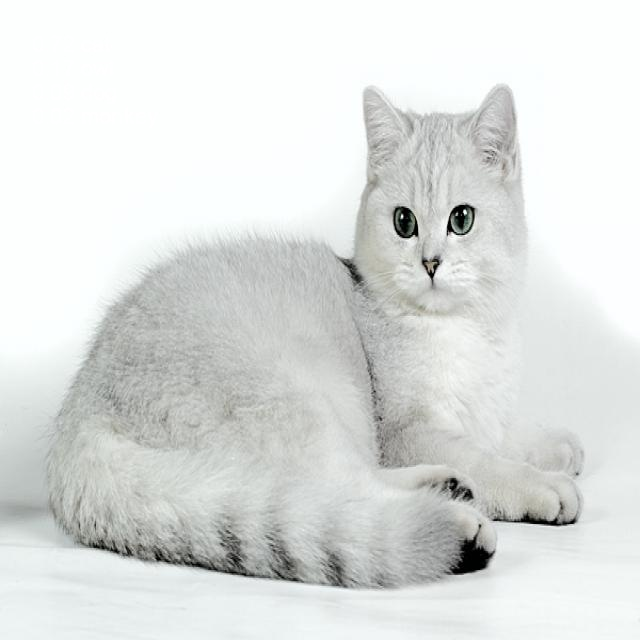

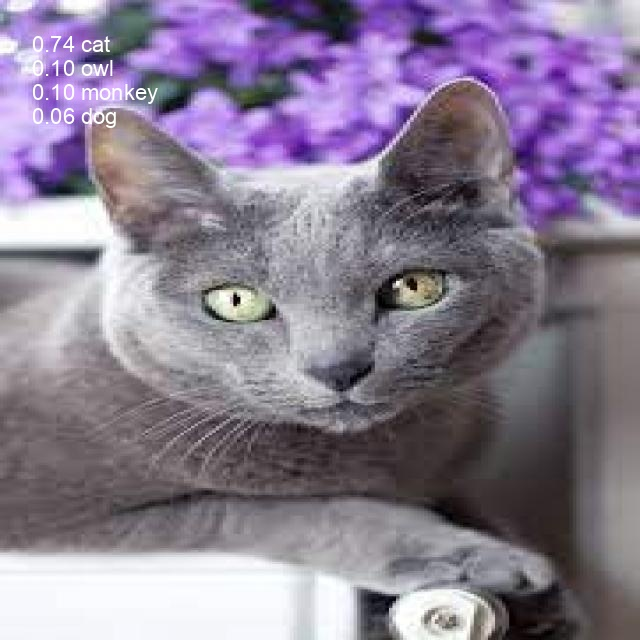

In [38]:
for imageName in glob.glob('/content/yolov5/runs/predict-cls/exp/*.jpg'):
    display(Image(filename=imageName))
    print("\n")

In [39]:
if os.path.exists(os.path.join(dataset.location, "test/owl")):
  split_path = os.path.join(dataset.location, "test/owl ")
  os.environ["TEST_IMAGES_OWL_PATH"] = os.path.join(dataset.location, "test/owl/")
else:
  os.environ["TEST_IMAGES_OWL_PATH"] = os.path.join(dataset.location, "valid/owl/")

!python classify/predict.py --weights runs/train-cls/exp/weights/best.pt --img 640 --source $TEST_IMAGES_OWL_PATH

classify/predict: weights=['runs/train-cls/exp/weights/best.pt'], source=/content/datasets/Animal-dataset-5/test/owl/, data=data/coco128.yaml, imgsz=[640, 640], device=, view_img=False, save_txt=False, nosave=False, augment=False, visualize=False, update=False, project=runs/predict-cls, name=exp, exist_ok=False, half=False, dnn=False, vid_stride=1
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-160-g867f7f0 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 166 layers, 11671316 parameters, 0 gradients, 30.6 GFLOPs
image 1/24 /content/datasets/Animal-dataset-5/test/owl/owl-1-_jpeg.rf.ddc463babc27e1187dc0a06ace51b00e.jpg: 640x640 owl 0.53, dog 0.45, monkey 0.02, cat 0.01, 17.0ms
image 2/24 /content/datasets/Animal-dataset-5/test/owl/owl-12-_jpg.rf.ca2efcc95b30caf92311006a4fd438bd.jpg: 640x640 owl 0.82, monkey 0.15, dog 0.03, cat 0.00, 17.0ms
image 3/24 /content/datasets/Animal-dataset-5/test/owl/owl-21-_jpg.rf.047

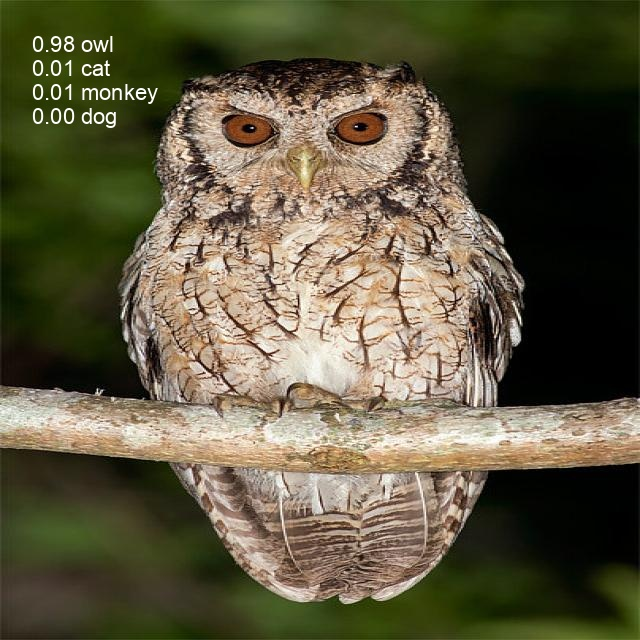

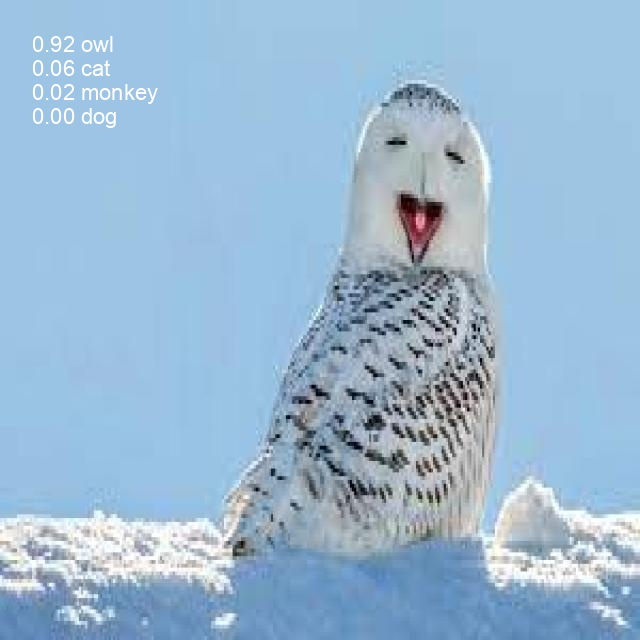

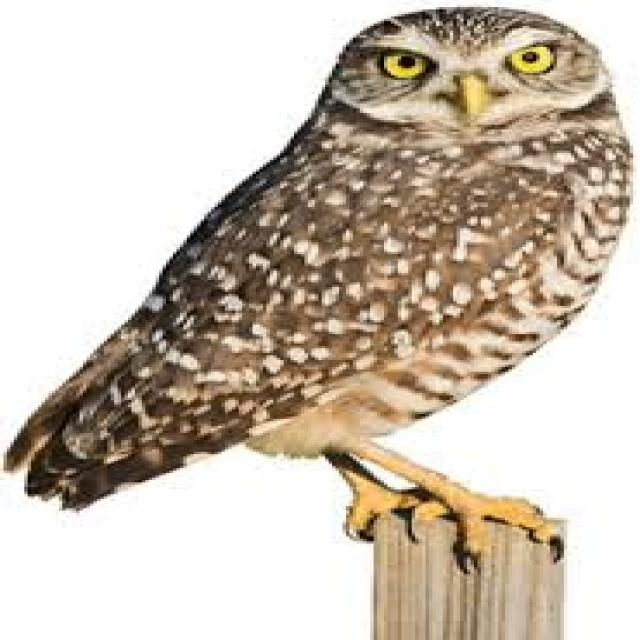

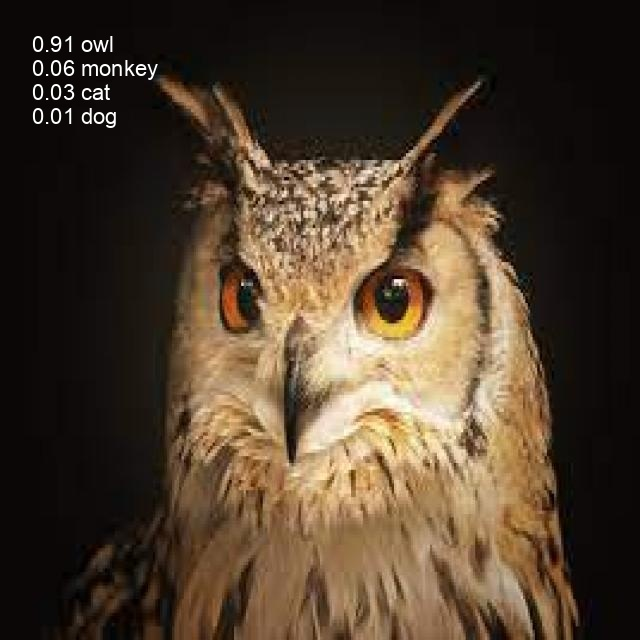

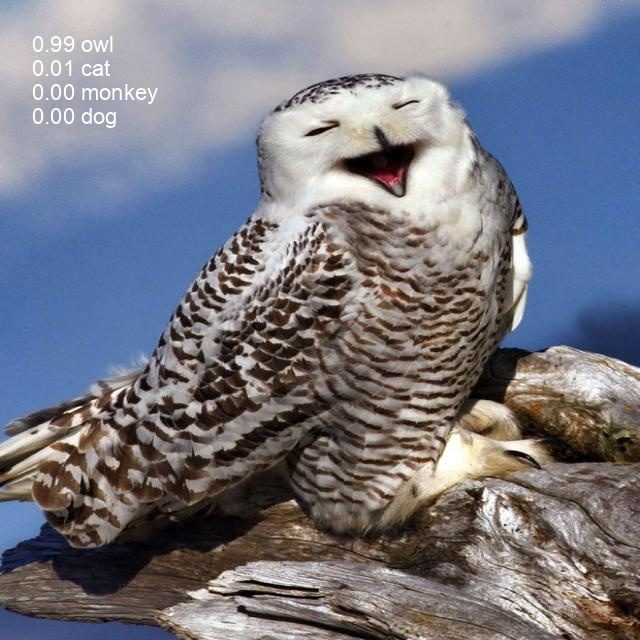

...

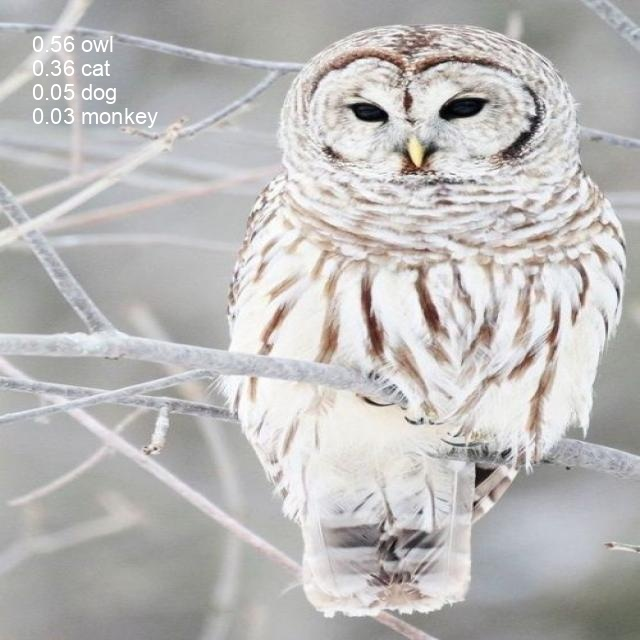

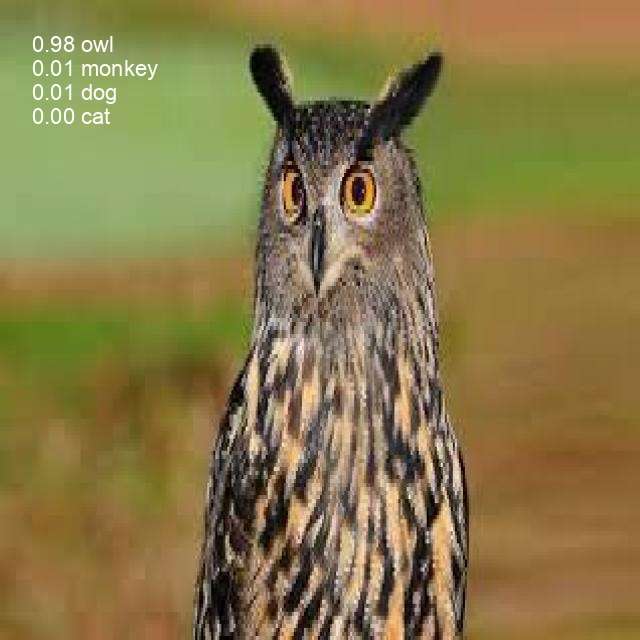

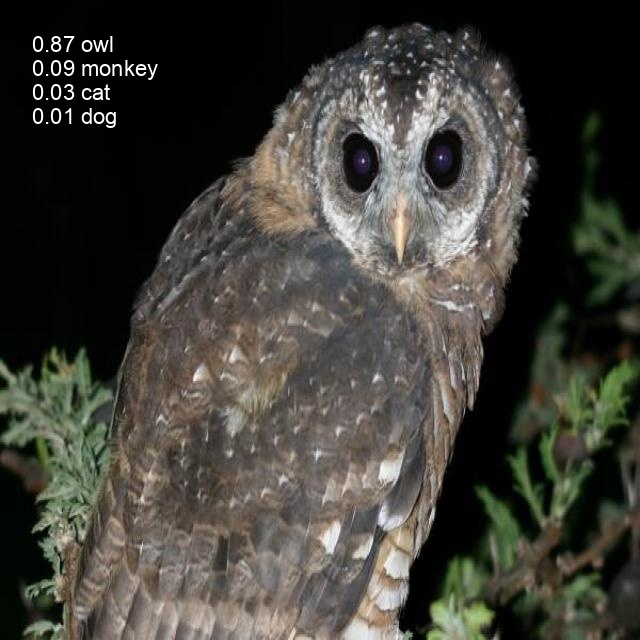

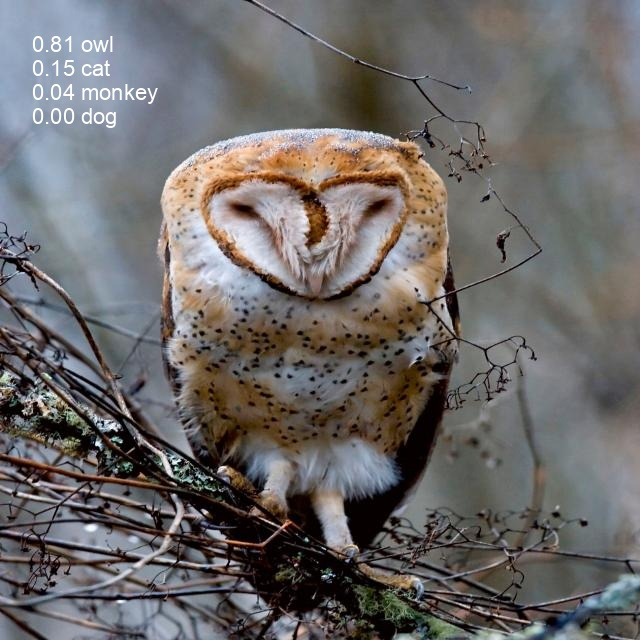

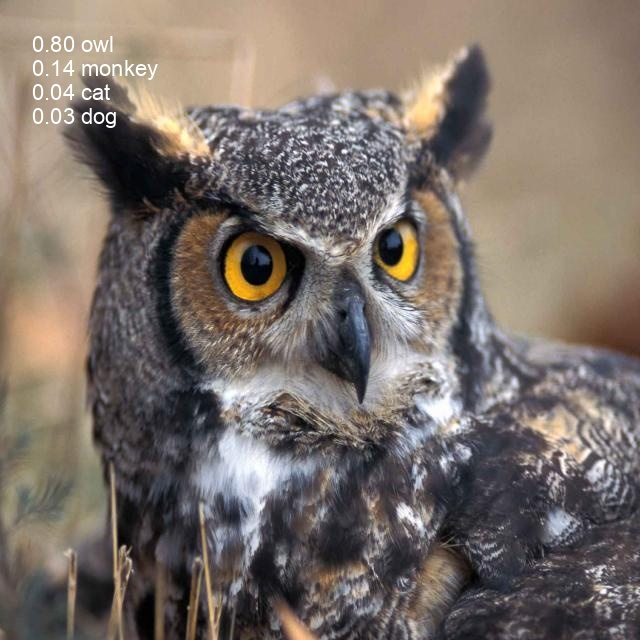

In [40]:
for imageName in glob.glob('/content/yolov5/runs/predict-cls/exp2/*.jpg'):
    display(Image(filename=imageName))
    print("\n")

In [41]:
if os.path.exists(os.path.join(dataset.location, "test/monkey")):
  split_path = os.path.join(dataset.location, "test/monkey ")
  os.environ["TEST_IMAGES_MONKEY_PATH"] = os.path.join(dataset.location, "test/monkey/")
else:
  os.environ["TEST_IMAGES_MONKEY_PATH"] = os.path.join(dataset.location, "valid/monkey/")

!python classify/predict.py --weights runs/train-cls/exp/weights/best.pt --img 640 --source $TEST_IMAGES_MONKEY_PATH

classify/predict: weights=['runs/train-cls/exp/weights/best.pt'], source=/content/datasets/Animal-dataset-5/test/monkey/, data=data/coco128.yaml, imgsz=[640, 640], device=, view_img=False, save_txt=False, nosave=False, augment=False, visualize=False, update=False, project=runs/predict-cls, name=exp, exist_ok=False, half=False, dnn=False, vid_stride=1
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-160-g867f7f0 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 166 layers, 11671316 parameters, 0 gradients, 30.6 GFLOPs
image 1/36 /content/datasets/Animal-dataset-5/test/monkey/Gorilla-Pende_jpg.rf.1dc6852762fc31a1e7a9d86ab1c5ab36.jpg: 640x640 monkey 0.87, cat 0.10, dog 0.02, owl 0.01, 17.1ms
image 2/36 /content/datasets/Animal-dataset-5/test/monkey/monkey-1-_jpeg.rf.a63bfca5b75eeba2b7a099db53593dc4.jpg: 640x640 monkey 0.66, cat 0.20, owl 0.12, dog 0.02, 17.1ms
image 3/36 /content/datasets/Animal-dataset-5/test/monk

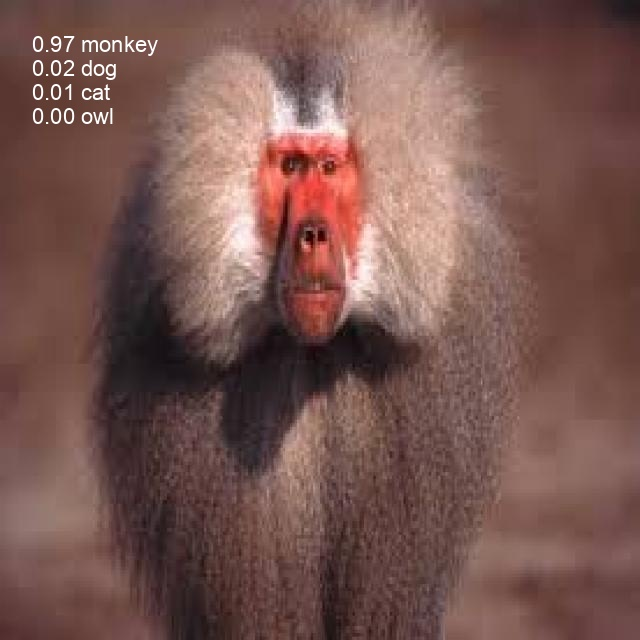

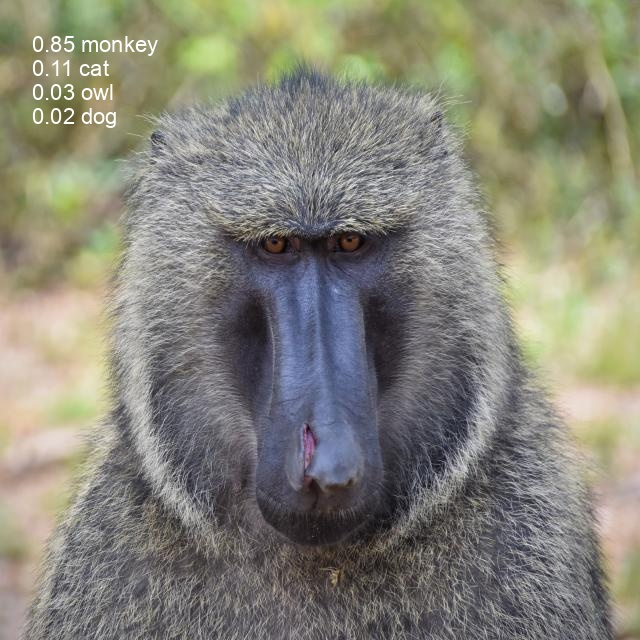

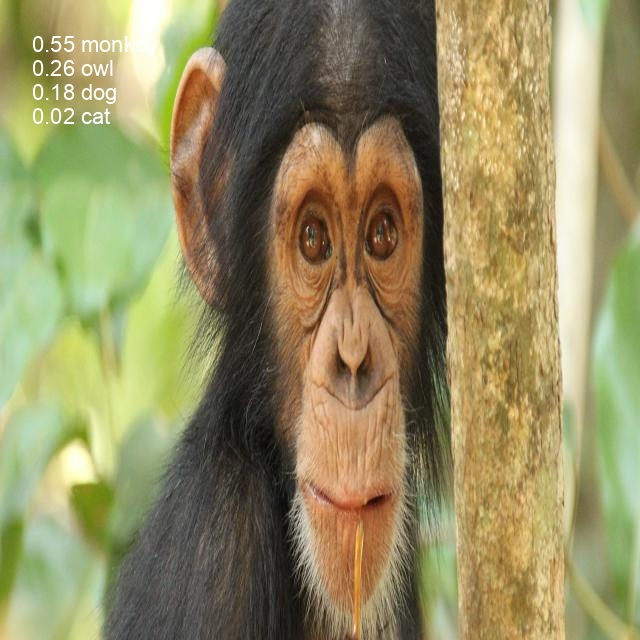

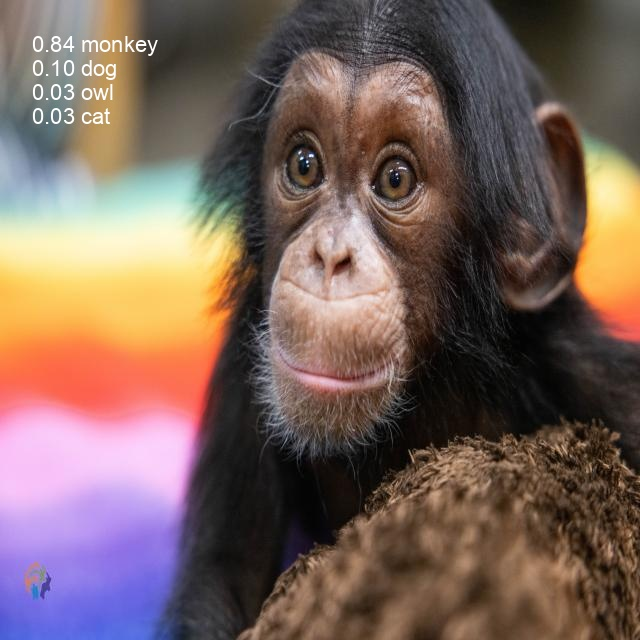

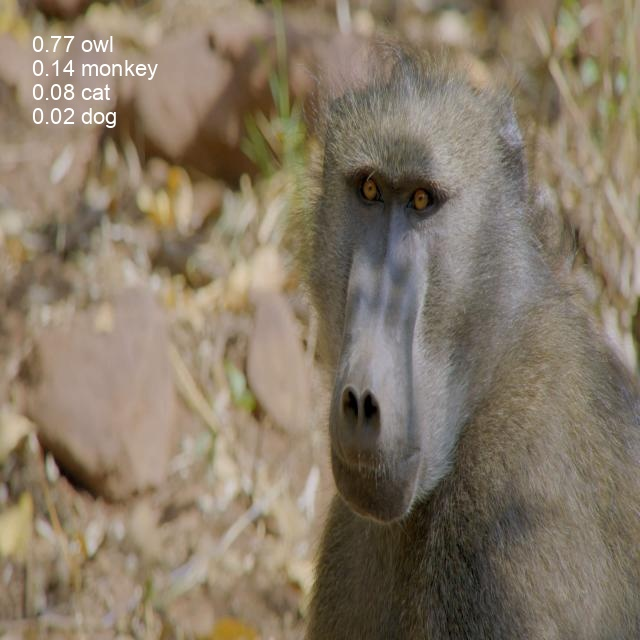

...

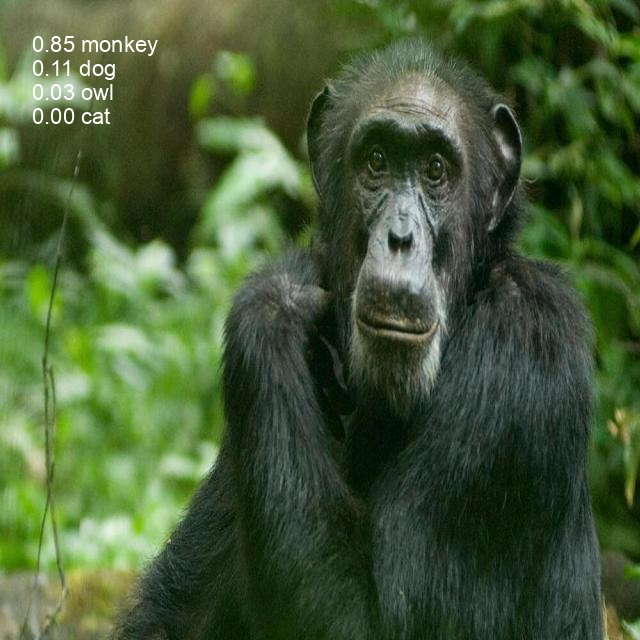

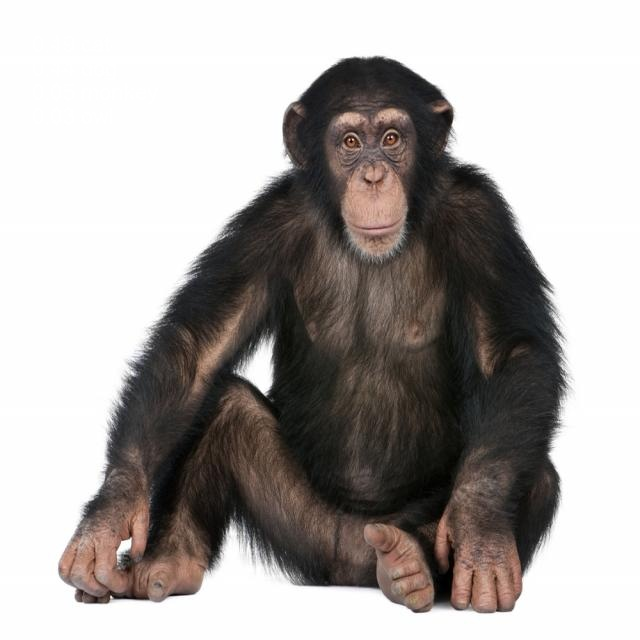

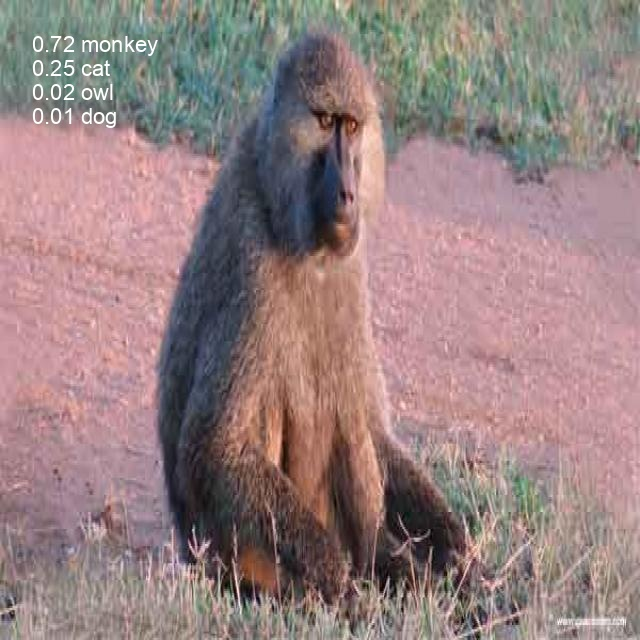

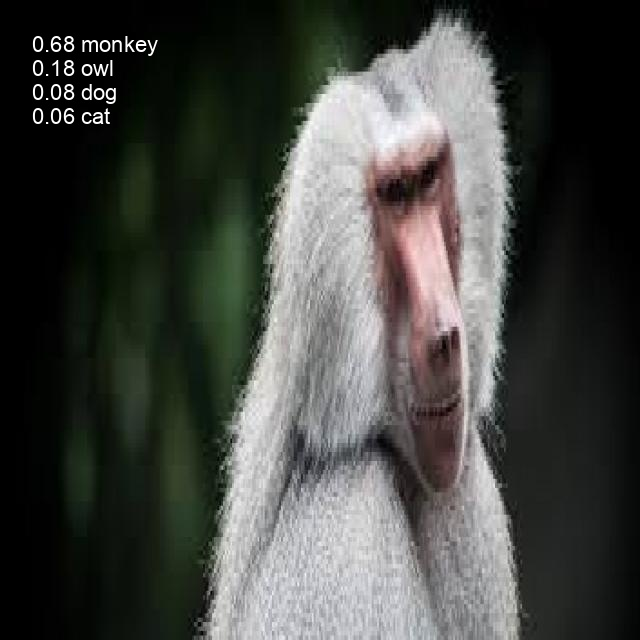

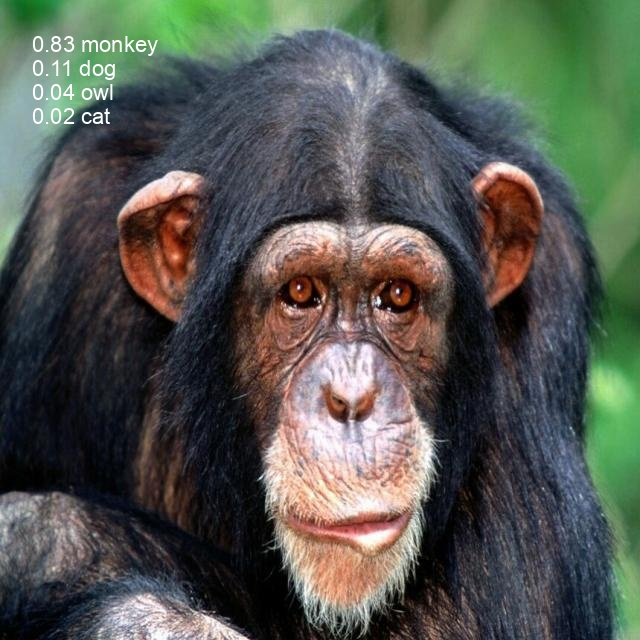

In [42]:
for imageName in glob.glob('/content/yolov5/runs/predict-cls/exp3/*.jpg'):
    display(Image(filename=imageName))
    print("\n")

In [27]:
from huggingface_hub import HfApi, login

login()

In [28]:
REPO_ID = "Lucas-Nardi/AnimalsPredict"
FILENAME = "best.pt"

# Sending to hagging face
api = HfApi()
api.upload_file(
    path_or_fileobj="./runs/train-cls/exp/weights/best.pt",
    path_in_repo=FILENAME,
    repo_id=REPO_ID,
    repo_type="model",
)

'https://huggingface.co/Lucas-Nardi/AnimalsPredict/blob/main/best.pt'

In [29]:
from google.colab import files
files.download('./runs/train-cls/exp/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>